# **RECOMENDACION DE PLAYLIST USANDO K MEANS**



Andres Paiz

Rene Ventura

Diego Crespo

Daniella villamar


# **LIBRERIAS A UTILIZAR**

In [2]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist



import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
import seaborn as sb
import sklearn.cluster as cluster
import sklearn.metrics as metrics
import sklearn.preprocessing
import scipy.cluster.hierarchy as sch
import pylab
import sklearn.mixture as mixture
import pyclustertend
import random
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture


from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.cm as cm

import warnings
warnings.filterwarnings("ignore")

In [4]:
cd Recomendacion

C:\Users\diego\Desktop\PROYECTO2DS-main\Recomendacion


# **Leemos los datos a utilizar**

In [5]:
data = pd.read_csv("data.csv")
genre_data = pd.read_csv('data_by_genres.csv')
year_data = pd.read_csv('data_by_year.csv')

In [6]:
data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055


In [8]:


#INICIA EL CLUSTERING

Lets = data[['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']] #Declaramos nuestra lista de columnas a trabajar

CantDatos = np.array(Lets.sample(frac=0.1, random_state=123).reset_index(drop=True)) #Declaramos CantDatos
CantDatos_scaled = sklearn.preprocessing.scale(CantDatos) #Realizamos las modificaicones a CantDatos
pyclustertend.hopkins(CantDatos, len(CantDatos)) #Aplicamos HOPKINS para ver  la tendencia para los clusters



0.0013610912102140697



El valor de hopkins nos da un 0.0.001361 alejado de 0.5 validando nuestro clustering.


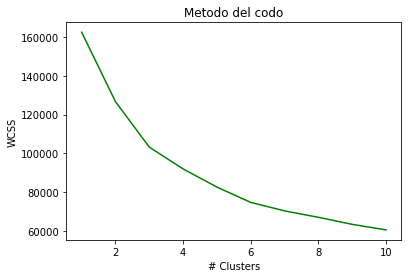

In [10]:


Lets_norm = (Lets - Lets.min()) / (Lets.max() - Lets.min())  #Realizamos una normalizacaion entre las variables a trabajar.
wcss = []

for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, max_iter=300)         #Utilizamos el metodo del codo y el algoritmo KMEANS
    kmeans.fit(Lets_norm)                                 #para determinar la mejor cantidad de clusters dependiendo los datos normalizados.
    wcss.append(kmeans.inertia_)

plt.plot(range(1, 11), wcss,color='green')
plt.title('Metodo del codo')
plt.xlabel('# Clusters')
plt.ylabel('WCSS')
plt.show()



Usando yellowbrick se crea una featureCorrelation lo cual crea una visualizacion de los coeficientes de correlacion de Pearson entre la variable dependiente (estamos usando la popularidad) y las features (se pueden ver dentro de feature_names) utilizando una escala de -1 a 1.

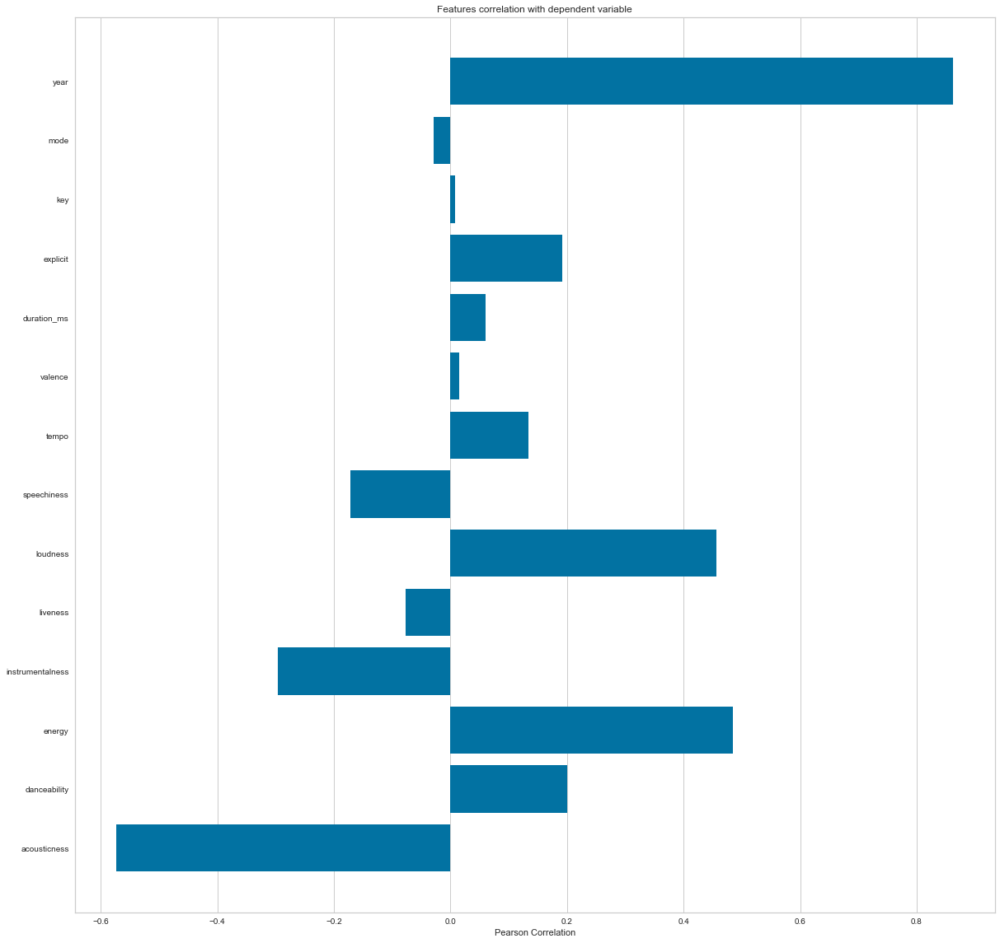

<AxesSubplot:title={'center':'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [12]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

Podemos observar como la acousticness es la feature que menos correlacion tiene con la popularidad y que el año es la feature que más correlacion tiene con la popularidad.

# **K-Means Clustering De Generos**

Se utiliza el algoritmo de K-means para dividir los generos en el dataset en 10 clusters, basandonos en las características numéricas de audio de cada género.

In [15]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [16]:
# Visualizacion de clusters usando TSNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.008s...
[t-SNE] Computed neighbors for 2973 samples in 0.231s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.110641
[t-SNE] KL divergence after 1000 iterations: 1.390078


# **K-Means Clustering de Canciones**

Hacemos el clustering de canciones.

In [18]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [19]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# **Sistema de recomendaciones**

* Según el análisis y las visualizaciones, se puede concluir que los géneros similares tienden a tener puntos de datos que se encuentran cerca unos de otros, mientras que los tipos de canciones similares también se agrupan.
* Los géneros similares sonarán de manera similar y provendrán de períodos de tiempo similares, mientras que lo mismo puede decirse de las canciones dentro de esos géneros. Podemos usar esta idea para construir un sistema de recomendación tomando los puntos de datos de las canciones que un usuario ha escuchado y recomendando canciones correspondientes a puntos de datos cercanos.
* Se utilizara spotipy para la siguiente seccion, por lo cual es necesario una client ID y un client secret para su cuenta en especifico.

In [ ]:
%pip install spotipy
%env SPOTIFY_CLIENT_ID=9c56eda59b544c55a63028477b5b7e18
%env SPOTIFY_CLIENT_SECRET=6fcc6b2dc613464a92c60ed4fc81cb52

*PREVIAMENTE SE INSTALA SPOTYPY Y POSTERIORMENTE SE UTILIZA MI (Andres Paiz) CLIENT ID Y CLIENT SECRET. AGRADECERIA QUE USARAN LOS SUYOS PARA PRUEBAS O NOTACION GRACIAS :)*

In [24]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ["SPOTIFY_CLIENT_ID"],
                                                           client_secret=os.environ["SPOTIFY_CLIENT_SECRET"]))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [26]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

Le pasamos a la funcion de recomendacion de canciones una playlist de 5 canciones y como output nos da una lista de recomendaciones basandose en la playlist de input.

Favor utilizar el mismo formato de input :v

In [33]:
recommend_songs([{'name': 'Robbery', 'year':2019},
                {'name': 'SAD!', 'year': 2018},
                {'name': 'Life is Beautiful', 'year': 2018},
                {'name': 'Lucid Dreams', 'year': 2018},
                {'name': 'La mano de Dios (Homenaje a Diego Maradona)', 'year': 2011}],  data)

[{'name': 'Congratulations',
  'year': 2016,
  'artists': "['Post Malone', 'Quavo']"},
 {'name': "I Think I'm OKAY (with YUNGBLUD & Travis Barker)",
  'year': 2019,
  'artists': "['Machine Gun Kelly', 'YUNGBLUD', 'Travis Barker']"},
 {'name': 'ROXANNE', 'year': 2019, 'artists': "['Arizona Zervas']"},
 {'name': 'Let Me Know (I Wonder Why Freestyle)',
  'year': 2019,
  'artists': "['Juice WRLD']"},
 {'name': 'Rider', 'year': 2019, 'artists': "['Juice WRLD']"},
 {'name': 'Play Date', 'year': 2015, 'artists': "['Melanie Martinez']"},
 {'name': 'Beamer Boy', 'year': 2017, 'artists': "['Lil Peep']"},
 {'name': 'Teardrops', 'year': 2020, 'artists': "['Bring Me The Horizon']"},
 {'name': "I Love You's", 'year': 2020, 'artists': "['Hailee Steinfeld']"},
 {'name': 'Parasite Eve', 'year': 2020, 'artists': "['Bring Me The Horizon']"}]

Aqui se mira el output de recomendacion para la playlist de input.